# Load real-world data and verify that functions run on it
### How to use this script
- If you need it interactive, convert it to a jupyter notebook with `p2j` -> `p2j test_sandbox_data.py`
- You can use `jupyter nbconvert --to python test_sandbox_data.ipynb` to convert it back
- Otherwise run it from the CLI and verify that the plots are okay

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import spatialdata as sd
import scanpy as sc
from spatialdata.datasets import blobs, raccoon
from spatialdata.models import (
    Image2DModel,
)

from spatialdata.transformations import (
    Affine,
    Identity,
    MapAxis,
    Scale,
    Sequence,
    Translation,
    get_transformation,
    get_transformation_between_coordinate_systems,
    set_transformation,
)
import anndata

import spatialdata_plot
assert spatialdata_plot.__name__ == "spatialdata_plot" # so mypy doesn't complain

DATA_DIR = "/Users/tim.treis/Documents/GitHub/spatialdata-sandbox/"

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/geopandas/_compat.py:123: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/Users/tim.treis/Documents/GitHub/spatialdata/src/spatialdata/__init__.py:9: UserWarning: Geopandas was set to use PyGEOS, changing to shapely 2.0 with:

	geopandas.options.use_pygeos = True

If you intended to use PyGEOS, set the option to False.
  _check_geopandas_using_shapely()


/Users/tim.treis/Documents/GitHub/spatialdata/src/spatialdata/_core/operations/aggregate.py:244: UserWarning: Converting `region_key: region` to categorical dtype.
  table = TableModel.parse(table, region=shapes_name, region_key=region_key, instance_key=instance_key)


WARNING  Multi-scale images not yet supported, using scale0 of multi-scale image 'blobs_multiscale_image'.         


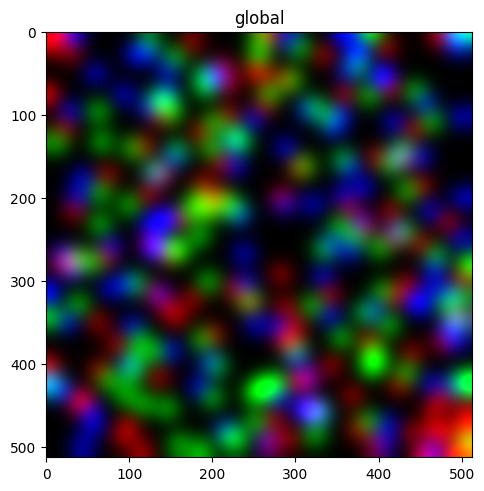

In [16]:
import spatialdata

blob = spatialdata.datasets.blobs()
# blob
# blob.pl.render_shapes().pl.show()
blob.pl.render_images().pl.show()

In [ ]:
a

In [ ]:
type(blob.labels["blobs_multiscale_labels"])

multiscale_spatial_image.multiscale_spatial_image.MultiscaleSpatialImage

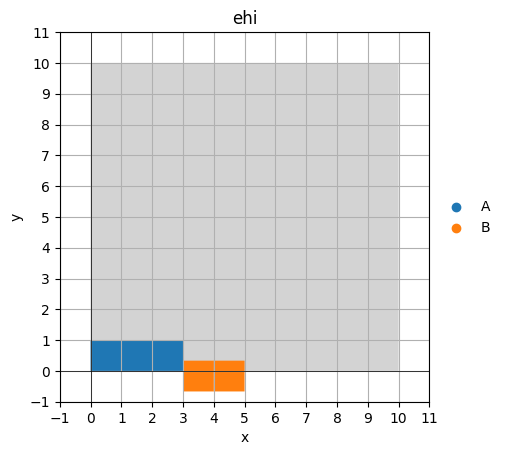

In [ ]:
import pandas as pd
from shapely import linearrings, polygons
import geopandas as gpd
from spatialdata.models import ShapesModel, TableModel
from anndata import AnnData
import spatialdata_plot
import matplotlib.pyplot as plt
import numpy as np
from spatialdata import SpatialData

# pre-commits would delete unused imports
_ = spatialdata_plot


def _make_squares(centroid_coordinates: np.ndarray, half_widths: list[float]) -> polygons:
    linear_rings = []
    for centroid, half_width in zip(centroid_coordinates, half_widths):
        min_coords = centroid - half_width
        max_coords = centroid + half_width

        linear_rings.append(
            linearrings(
                [
                    [min_coords[0], min_coords[1]],
                    [min_coords[0], max_coords[1]],
                    [max_coords[0], max_coords[1]],
                    [max_coords[0], min_coords[1]],
                ]
            )
        )
    s = polygons(linear_rings)
    polygon_series = gpd.GeoSeries(s)
    cell_polygon_table = gpd.GeoDataFrame(geometry=polygon_series)
    return ShapesModel.parse(cell_polygon_table)


square = _make_squares(np.atleast_2d([5, 5]), half_widths=[5])
little_squares = _make_squares(
    np.atleast_2d([[0.5, 0.5], [1.5, 0.5], [2.5, 0.5], [3.5, -1 / 6.0], [4.5, -1 / 6.0]]),
    half_widths=[0.5, 0.5, 0.5, 0.5, 0.5],
)

if True:
    little_squares['type'] = pd.Categorical(['A', 'A', 'A', 'B', 'B'])
    table = None
else:
    table = AnnData(shape=(5, 0), obs=pd.DataFrame({'type': ['A', 'A', 'A', 'B', 'B']}))
    table.obs['type'] = table.obs['type'].astype('category')
    table.obs['region'] = 'little_squares'
    table.obs['region'] = table.obs['region'].astype('category')
    table.obs['instance_id'] = [0, 1, 2, 3, 4]
    table = TableModel.parse(table, region='little_squares', region_key='region', instance_key='instance_id')

ax = plt.gca()
test_sdata = SpatialData(shapes={"square": square, "little_squares": little_squares}, table=table)
test_sdata.pl.render_shapes("square").pl.show(ax=ax)
test_sdata.pl.render_shapes("little_squares", color='type').pl.show(ax=ax)

# set limits
ax.set_xlim(-1, 7)
ax.set_ylim(-1, 7)

# set ticks
ax.set_xticks(range(-1, 12))
ax.set_yticks(range(-1, 12))

# show axes
ax.axhline(0, color="black", linewidth=0.5)
ax.axvline(0, color="black", linewidth=0.5)

# set labels
ax.set_xlabel("x")
ax.set_ylabel("y")

# show grid
ax.grid(True)
ax.set_title("ehi")

plt.show()

In [ ]:
from spatialdata._core.query.relational_query import _locate_value

_locate_value(value_key="type", element=test_sdata.shapes["little_squares"])

/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/basic.py:55: AccessorRegistrationWarning: registration of accessor <class 'spatialdata_plot.pl.basic.PlotAccessor'> under name 'pl' for type <class 'spatialdata._core.spatialdata.SpatialData'> is overriding a preexisting attribute with the same name.
  class PlotAccessor:


[_ValueOrigin(origin='df', is_categorical=False, value_key='type')]

/Users/tim.treis/Documents/GitHub/spatialdata/src/spatialdata/_core/operations/aggregate.py:244: UserWarning: Converting `region_key: region` to categorical dtype.
  table = TableModel.parse(table, region=shapes_name, region_key=region_key, instance_key=instance_key)


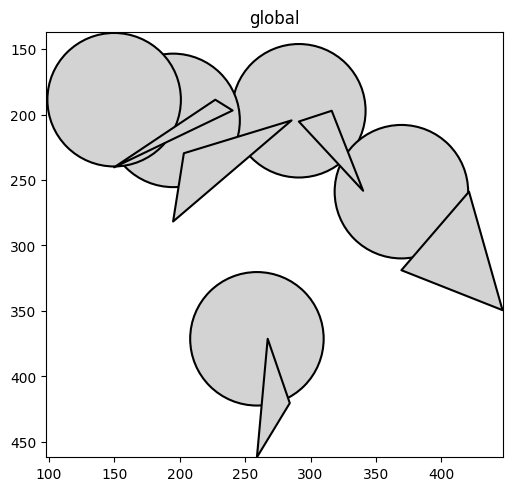

In [ ]:
from spatialdata.datasets import blobs
import spatialdata_plot

blob = blobs()
blob.pl.render_shapes(outline=True).pl.show()

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:278: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = ax.scatter(


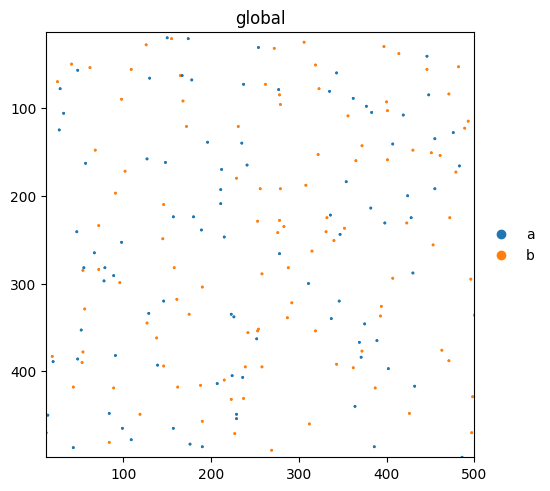

In [ ]:
sdata = blobs()
(
    sdata
    .pl.render_points(color="genes")
    # .pl.render_shapes("blobs_polygons")
    .pl.show()
)

AttributeError: 'function' object has no attribute 'dtype'

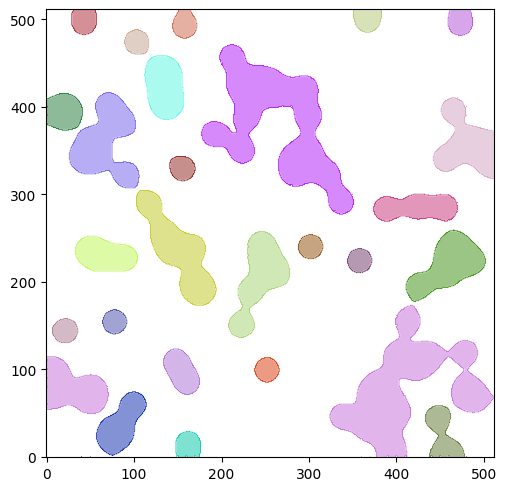

In [ ]:
sdata.pl.render_labels().pl.show()

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


library
library


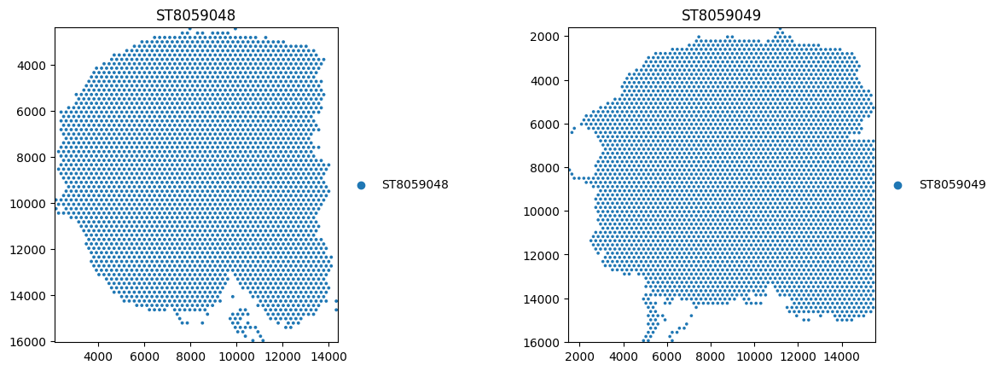

In [ ]:
import spatialdata as sd
import spatialdata_plot
from matplotlib import pyplot as plt
sdata = sd.read_zarr("/Users/tim.treis/Documents/GitHub/spatialdata-notebooks/notebooks/examples/visium.zarr") # visium.zarr from sdata tutorial
sdata.pl.render_shapes(color="library").pl.show()

In [ ]:
sdata

SpatialData object with:
├── Images
│     ├── 'ST8059048_image': SpatialImage[cyx] (3, 2000, 1969)
│     └── 'ST8059049_image': SpatialImage[cyx] (3, 2000, 1969)
├── Shapes
│     ├── 'ST8059048_shapes': GeoDataFrame shape: (2987, 2) (2D shapes)
│     └── 'ST8059049_shapes': GeoDataFrame shape: (3499, 2) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 6486 × 31053
    obs: 'in_tissue', 'array_row', 'array_col', 'annotating', 'library', 'spot_id'
    uns: 'spatialdata_attrs', 'library_colors': AnnData (6486, 31053)
with coordinate systems:
▸ 'ST8059048', with elements:
        ST8059048_image (Images), ST8059048_shapes (Shapes)
▸ 'ST8059049', with elements:
        ST8059049_image (Images), ST8059049_shapes (Shapes)

In [ ]:
_locate_value(value_key="library", sdata=sdata, element_name="ST8059048_shapes")

[_ValueOrigin(origin='obs', is_categorical=True, value_key='library')]

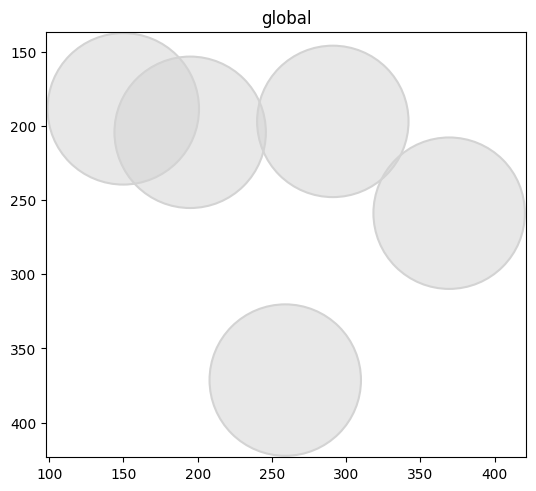

In [ ]:
sdata.pl.render_shapes("blobs_circles", outline=True, fill_alpha=0.5).pl.show()

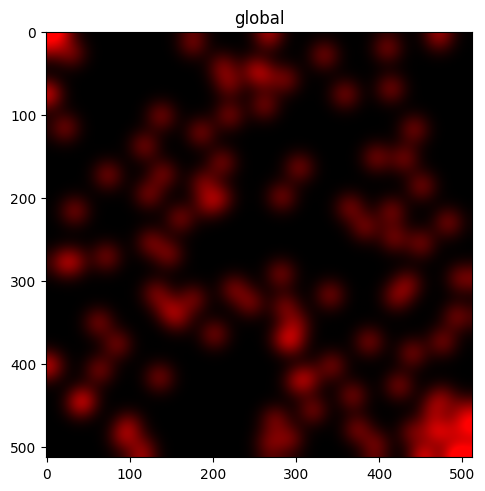

In [ ]:
sdata = blobs()

sdata.pl.render_images("blobs_image", channel=0, palette="red").pl.show()

WARNING  You're blending multiple cmaps. If the plot doesn't look like you expect, it might be because your cmaps  
         go from a given color to 'white', and not to 'transparent'. Therefore, the 'white' of higher layers will  
         overlay the lower layers. Consider using 'palette' instead.                                               


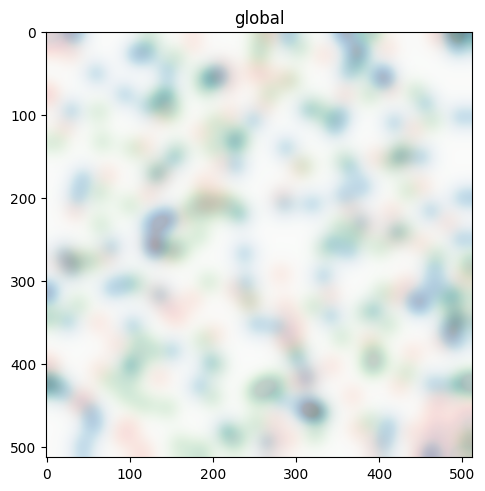

In [ ]:
sdata.pl.render_images("blobs_image", channel=[0, 1, 2], cmap=["Reds", "Greens", "Blues"]).pl.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


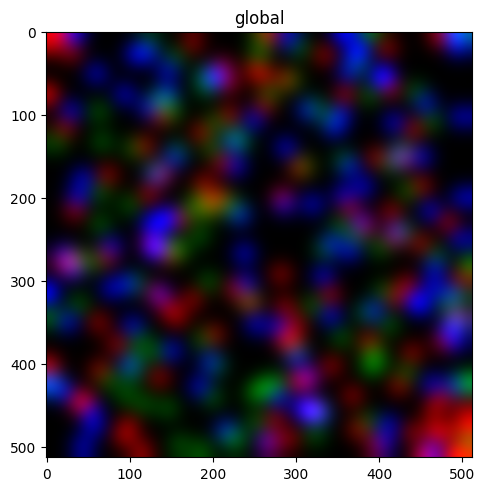

In [ ]:
sdata.pl.render_images("blobs_image", channel=[0, 1, 2], palette=["red", "green", "blue"]).pl.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


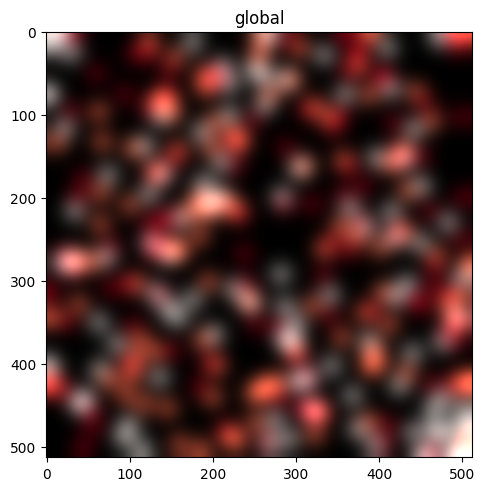

In [ ]:
sdata.pl.render_images("blobs_image", cmap="Reds").pl.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


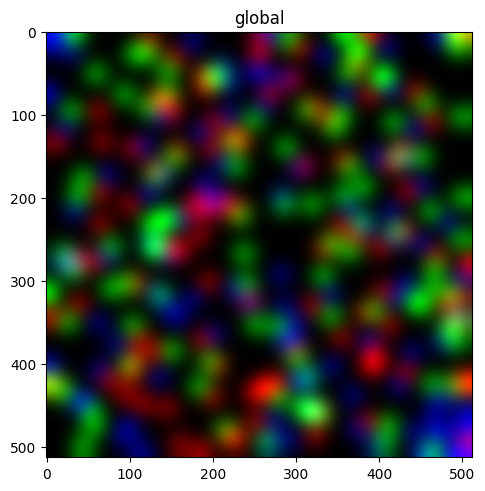

In [ ]:
sdata.pl.render_images("blobs_image").pl.show()

INFO     Transposing `data` of type: <class 'dask.array.core.Array'> to ('c', 'y', 'x').                           


/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


#000000ff
(0.0, 0.0, 0.0, 1.0)


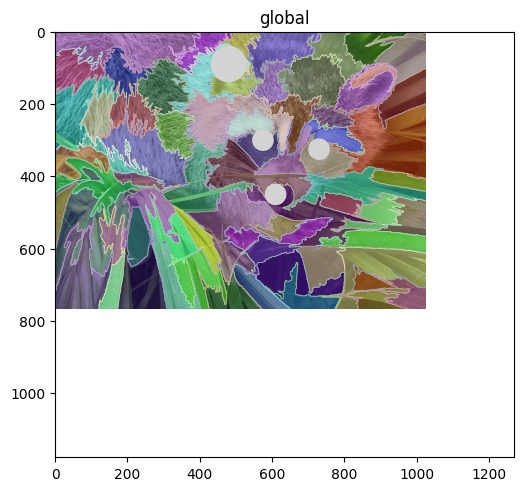

In [ ]:
sdata = raccoon()
import math
theta = math.pi / 6
rotation = Affine(
    [
        [math.cos(theta), -math.sin(theta), 0],
        [math.sin(theta), math.cos(theta), 0],
        [0, 0, 1],
    ],
    input_axes=("x", "y"),
    output_axes=("x", "y"),
)

set_transformation(sdata.images["raccoon"], rotation, to_coordinate_system="global")

sdata.pl.render_images().pl.render_labels().pl.render_shapes().pl.show()

KeyError: 'blobs_circles'

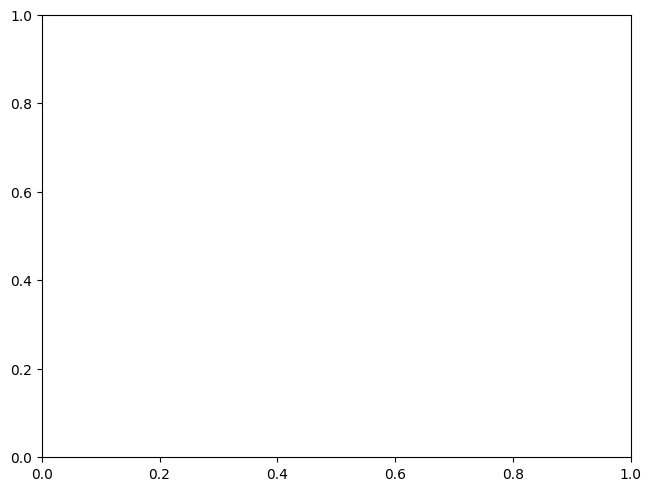

In [ ]:
sdata.pl.render_shapes("blobs_circles", outline=True).pl.show()

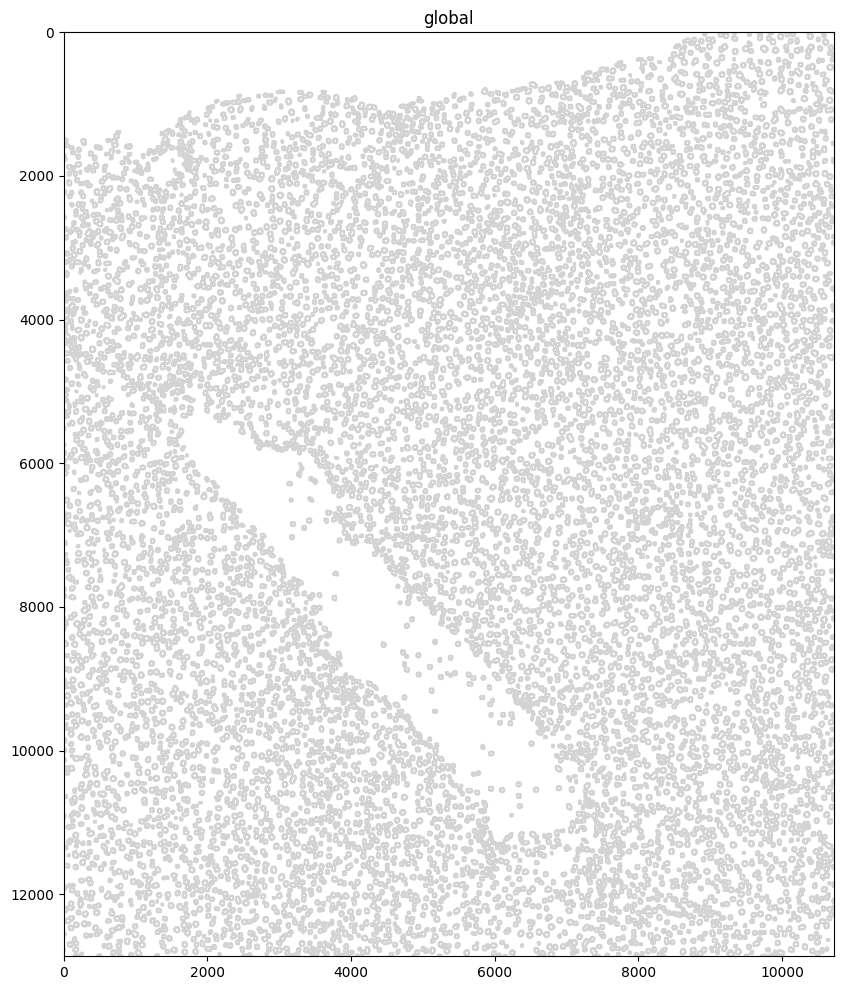

In [ ]:
import spatialdata as sd
import spatialdata_plot
from spatialdata.models import ShapesModel
import pandas as pd
import geopandas as gpd

fig, ax = plt.subplots(figsize=(12,12))

def _make_multi():

    multipolygon = gpd.read_file('/Users/tim.treis/Downloads/adataA1-1.geojson')
    # multipolygon = multipolygon[[e.geom_type != "Polygon" for e in multipolygon.geometry]]["geometry"].values
    multipolygon = multipolygon["geometry"].values
    multipolygon = gpd.GeoSeries(multipolygon)
    multipolygon = gpd.GeoDataFrame(geometry=multipolygon)
    sd_polygons = ShapesModel.parse(multipolygon)
    return sd_polygons

multi = _make_multi()
sdata = sd.SpatialData(shapes={"p": _make_multi()})
sdata.pl.render_shapes(outline=True, fill_alpha=0, palette="red").pl.show(ax=ax) # fails
# ax.set_xlim(1400, 1600)
# ax.set_ylim(1300, 1500)


In [ ]:
print(sdata.shapes["p"].iloc[1].values[0])

MULTIPOLYGON (((2414 945, 2418 945, 2418 942, 2414 942, 2414 945)), ((2418 948, 2414 948, 2414 955, 2405 955, 2405 952, 2401 952, 2401 948, 2398 948, 2398 955, 2395 955, 2395 961, 2398 961, 2398 965, 2401 965, 2401 971, 2405 971, 2405 978, 2414 978, 2414 994, 2418 994, 2418 997, 2424 997, 2424 1000, 2443 1000, 2443 997, 2450 997, 2450 994, 2453 994, 2453 987, 2466 987, 2466 981, 2469 981, 2469 961, 2466 961, 2466 948, 2463 948, 2463 945, 2460 945, 2460 948, 2440 948, 2440 939, 2447 939, 2447 932, 2443 932, 2443 929, 2424 929, 2424 932, 2421 932, 2421 939, 2431 939, 2431 948, 2421 948, 2421 945, 2418 945, 2418 948)))


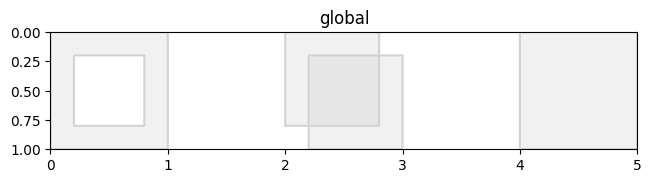

In [ ]:
import spatialdata as sd
import spatialdata_plot
from spatialdata.models import ShapesModel
from shapely.geometry import Polygon, MultiPolygon
import pandas as pd
import geopandas as gpd


def _make_multi():
    hole = MultiPolygon([(
        ((0.0, 0.0), (0.0, 1.0), (1.0, 1.0), (1.0, 0.0)),
         [((0.2,0.2), (0.2,0.8), (0.8,0.8), (0.8,0.2))]
    )])
    overlap = MultiPolygon([
        Polygon([(2.0, 0.0), (2.0, 0.8), (2.8, 0.8), (2.8, 0.0)]),
        Polygon([(2.2, 0.2), (2.2, 1.0), (3.0, 1.0), (3.0, 0.2)])
    ])
    poly = Polygon([(4.0, 0.0), (4.0, 1.0), (5.0, 1.0), (5.0, 0.0)])
    polygon_series = gpd.GeoSeries([hole, overlap, poly])
    cell_polygon_table = gpd.GeoDataFrame(geometry=polygon_series)
    sd_polygons = ShapesModel.parse(cell_polygon_table)
    return sd_polygons

multi = _make_multi()
sdata = sd.SpatialData(shapes={"p": _make_multi()})
sdata.pl.render_shapes(outline=True, fill_alpha=0.3).pl.show()


/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:286: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = ax.scatter(


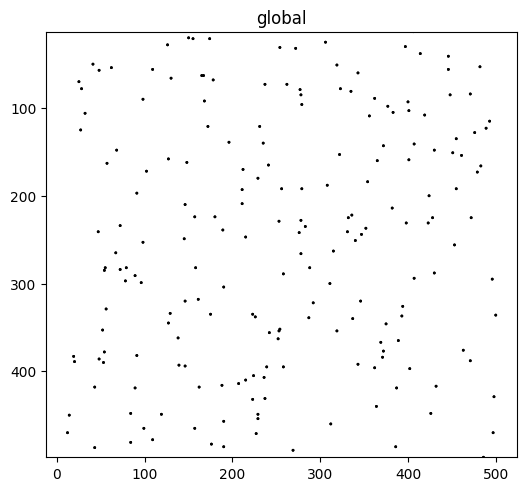

In [ ]:
blob = sd.datasets.blobs()
# print(blob)
# blob.pl.render_images("blobs_image").pl.show()
blob.pl.render_points(elements=["blobs_points"]).pl.show()

In [ ]:
import spatialdata as sd
import numpy as np

sdata = sd.SpatialData()
sdata.add_image(
    'img',
    image = sd.models.Image2DModel.parse(
        data = np.random.rand(4, 100, 100),
        dims = ['c', 'y', 'x'],
        c_coords = ['c1', 'c2', 'c3', 'c4']
    )
)
print(sdata.images["img"])

<xarray.SpatialImage 'image' (c: 4, y: 100, x: 100)>
dask.array<array, shape=(4, 100, 100), dtype=float64, chunksize=(4, 100, 100), chunktype=numpy.ndarray>
Coordinates:
  * c        (c) <U2 'c1' 'c2' 'c3' 'c4'
  * y        (y) float64 0.5 1.5 2.5 3.5 4.5 5.5 ... 95.5 96.5 97.5 98.5 99.5
  * x        (x) float64 0.5 1.5 2.5 3.5 4.5 5.5 ... 95.5 96.5 97.5 98.5 99.5
Attributes:
    transform:  {'global': Identity }


In [ ]:
from spatialdata.transformations import get_transformation
from spatialdata import transform

t = get_transformation(sdata.images["img"])
sdata.images["img"] = transform(sdata.images["img"], t)
print(sdata.images["img"])

<xarray.SpatialImage 'image' (c: 4, y: 100, x: 100)>
dask.array<affine_transform, shape=(4, 100, 100), dtype=float64, chunksize=(4, 100, 100), chunktype=numpy.ndarray>
Coordinates:
  * c        (c) int64 0 1 2 3
  * y        (y) float64 0.5 1.5 2.5 3.5 4.5 5.5 ... 95.5 96.5 97.5 98.5 99.5
  * x        (x) float64 0.5 1.5 2.5 3.5 4.5 5.5 ... 95.5 96.5 97.5 98.5 99.5
Attributes:
    transform:  {'global': Sequence \n    Translation (c, y, x)\n        [0. ...


In [ ]:
sdata = sd.read_zarr("./str_idx_test.zarr")
sdata.images

{'img': <xarray.SpatialImage 'img' (c: 4, y: 100, x: 100)>
 dask.array<from-zarr, shape=(4, 100, 100), dtype=float64, chunksize=(4, 100, 100), chunktype=numpy.ndarray>
 Coordinates:
   * c        (c) <U2 'c1' 'c2' 'c3' 'c4'
   * y        (y) float64 0.5 1.5 2.5 3.5 4.5 5.5 ... 95.5 96.5 97.5 98.5 99.5
   * x        (x) float64 0.5 1.5 2.5 3.5 4.5 5.5 ... 95.5 96.5 97.5 98.5 99.5
 Attributes:
     transform:  {'global': Identity }}

/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/basic.py:53: AccessorRegistrationWarning: registration of accessor <class 'spatialdata_plot.pl.basic.PlotAccessor'> under name 'pl' for type <class 'spatialdata._core.spatialdata.SpatialData'> is overriding a preexisting attribute with the same name.
  class PlotAccessor:


{'global': (0.0, 100, 0.0, 100)}


KeyError: "not all values found in index 'c'"

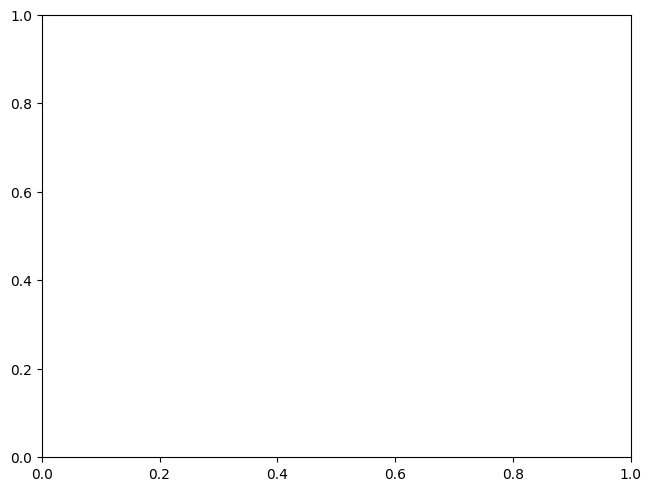

In [ ]:
(
    sdata
    .pl.render_images('img', channel=['c1', 'c2'], palette=['red', 'green'])
    .pl.show(coordinate_systems='global')
)

In [ ]:
from numpy.random import default_rng

RNG = default_rng()

out = {}
dims_2d = ("c", "y", "x")
out["img"] = Image2DModel.parse(RNG.normal(size=(3, 64, 64)), dims=dims_2d, c_coords=["c", "y", "x"])


In [ ]:
sd.datasets.blobs()

SpatialData object with:
├── Images
│     ├── 'blobs_image': SpatialImage[cyx] (3, 512, 512)
│     └── 'blobs_multiscale_image': MultiscaleSpatialImage[cyx] (3, 512, 512), (3, 256, 256), (3, 128, 128)
├── Labels
│     ├── 'blobs_labels': SpatialImage[yx] (512, 512)
│     └── 'blobs_multiscale_labels': MultiscaleSpatialImage[yx] (512, 512), (256, 256), (128, 128)
├── Points
│     └── 'blobs_points': DataFrame with shape: (<Delayed>, 4) (2D points)
├── Shapes
│     ├── 'blobs_circles': GeoDataFrame shape: (5, 2) (2D shapes)
│     ├── 'blobs_multipolygons': GeoDataFrame shape: (5, 1) (2D shapes)
│     └── 'blobs_polygons': GeoDataFrame shape: (5, 1) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 26 × 3
    obs: 'region', 'instance_id'
    uns: 'spatialdata_attrs': AnnData (26, 3)
with coordinate systems:
▸ 'global', with elements:
        blobs_image (Images), blobs_multiscale_image (Images), blobs_labels (Labels), blobs_multiscale_labels (Labels), blobs_points (Poin

In [ ]:
[geom.exterior for geom in sdata.shapes["p"].iloc[1,0].geoms]

[<LINEARRING (0 0, 0 1, 1 1, 1 0, 0 0)>]

In [ ]:
blob = sd.datasets.blobs()
blob

[autoreload of spatialdata_plot.pl.basic failed: Traceback (most recent call last):
  File "/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/IPython/extensions/autoreload.py", line 261, in check
    superreload(m, reload, self.old_objects)
  File "/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/IPython/extensions/autoreload.py", line 459, in superreload
    module = reload(module)
  File "/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 619, in _exec
  File "<frozen importlib._bootstrap_external>", line 883, in exec_module
  File "<frozen importlib._bootstrap>", line 241, in _call_with_frames_removed
  File "/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/basic.py", line 35, in <module>
    from spatialdata_plot.pl.utils import (
ImportError: cannot import name '_mpl_ax_contains_

SpatialData object with:
├── Images
│     ├── 'blobs_image': SpatialImage[cyx] (3, 512, 512)
│     └── 'blobs_multiscale_image': MultiscaleSpatialImage[cyx] (3, 512, 512), (3, 256, 256), (3, 128, 128)
├── Labels
│     ├── 'blobs_labels': SpatialImage[yx] (512, 512)
│     └── 'blobs_multiscale_labels': MultiscaleSpatialImage[yx] (512, 512), (256, 256), (128, 128)
├── Points
│     └── 'blobs_points': DataFrame with shape: (<Delayed>, 4) (2D points)
├── Shapes
│     ├── 'blobs_circles': GeoDataFrame shape: (5, 2) (2D shapes)
│     ├── 'blobs_multipolygons': GeoDataFrame shape: (5, 1) (2D shapes)
│     └── 'blobs_polygons': GeoDataFrame shape: (5, 1) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 26 × 3
    obs: 'region', 'instance_id'
    uns: 'spatialdata_attrs': AnnData (26, 3)
with coordinate systems:
▸ 'global', with elements:
        blobs_image (Images), blobs_multiscale_image (Images), blobs_labels (Labels), blobs_multiscale_labels (Labels), blobs_points (Poin

UnboundLocalError: local variable 'x_min_orig' referenced before assignment

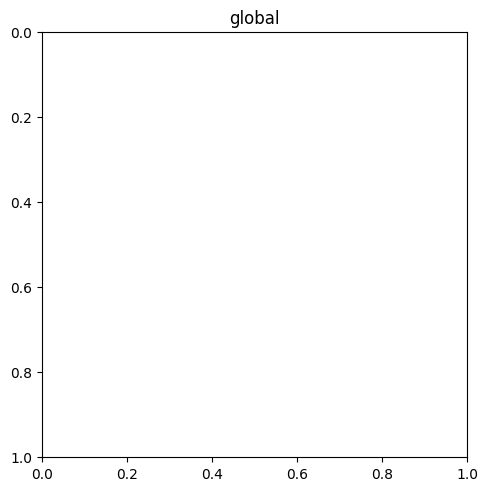

In [ ]:
blob.pl.render_shapes(elements="blobs_polygons").pl.show()

KeyError: 'c'

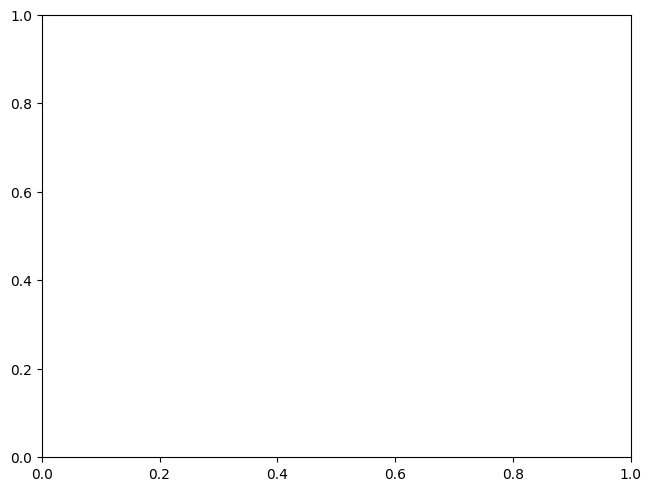

In [ ]:
sdata.pl.render_shapes(element='s', na_color='y').pl.render_shapes(element='c', na_color='g').pl.render_points().pl.show()

In [ ]:
table = anndata.AnnData(None, obs=pd.DataFrame(index=pd.Index(np.arange(len(blob.shapes)), dtype=str)))



Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20],
           dtype='int64') None segmentation_labels
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20],
           dtype='int64') None segmentation_labels
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20],
           dtype='int64') None segmentation_labels


SpatialData object with:
├── Images
│     ├── 'mousebrain_hires_image': SpatialImage[cyx] (3, 2000, 1969)
│     └── 'mousebrain_lowres_image': SpatialImage[cyx] (3, 600, 591)
├── Shapes
│     └── 'mousebrain': GeoDataFrame shape: (2871, 2) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 2871 × 17066
    obs: 'in_tissue', 'array_row', 'array_col', 'spot_id', 'region', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'segmentation_labels', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'leiden_colors', 'log1p', 'segmentation_labels_colors', 'spatial', 'spatialdata_attrs'
    

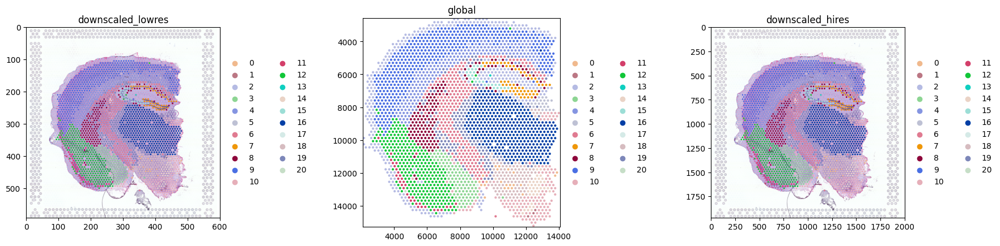

In [ ]:
sdata = sd.read_zarr("/Users/tim.treis/Documents/GitHub/spatialdata-plot/test.zarr")

(

    sdata.pl.render_images().
             pl.render_shapes(color="segmentation_labels").
             pl.show()

)
sdata

INFO     Transposing `data` of type: <class 'dask.array.core.Array'> to ('c', 'y', 'x').                           


/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


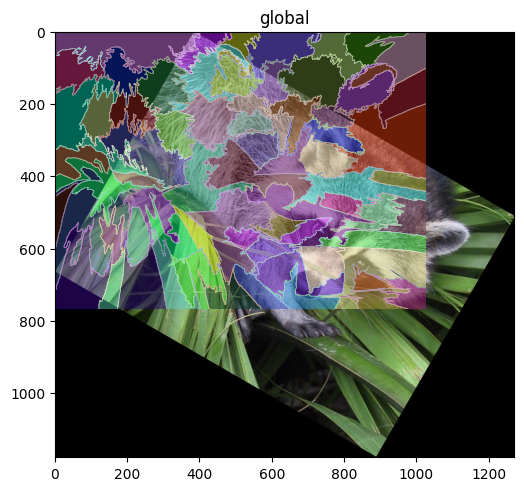

In [ ]:
import math

sdata = raccoon()

scale = Scale([2.0], axes=("x",))
theta = math.pi / 6
rotation = Affine(
    [
        [math.cos(theta), -math.sin(theta), 0],
        [math.sin(theta), math.cos(theta), 0],
        [0, 0, 1],
    ],
    input_axes=("x", "y"),
    output_axes=("x", "y"),
)
translation = Translation([500, 300], axes=("x", "y"))

sequence = Sequence([rotation, scale])

set_transformation(sdata.images["raccoon"], rotation, to_coordinate_system="global")

# sdata.pl.render_images().pl.show()
sdata.pl.render_images().pl.render_labels().pl.show()


ax = plt.gca()

# ax.set_xlim(500.0, 2024,)

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


SpatialData object with:
├── Images
│     ├── 'ST8059050_image': SpatialImage[cyx] (3, 2000, 1968)
│     └── 'ST8059051_image': SpatialImage[cyx] (3, 2000, 1963)
├── Shapes
│     ├── 'ST8059050_shapes': GeoDataFrame shape: (3497, 2) (2D shapes)
│     └── 'ST8059051_shapes': GeoDataFrame shape: (2409, 2) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 5906 × 31053
    obs: 'in_tissue', 'array_row', 'array_col', 'annotating', 'library', 'spot_id'
    uns: 'spatialdata_attrs': AnnData (5906, 31053)
with coordinate systems:
▸ 'ST8059050', with elements:
        ST8059050_image (Images), ST8059050_shapes (Shapes)
▸ 'ST8059051', with elements:
        ST8059051_image (Images), ST8059051_shapes (Shapes)


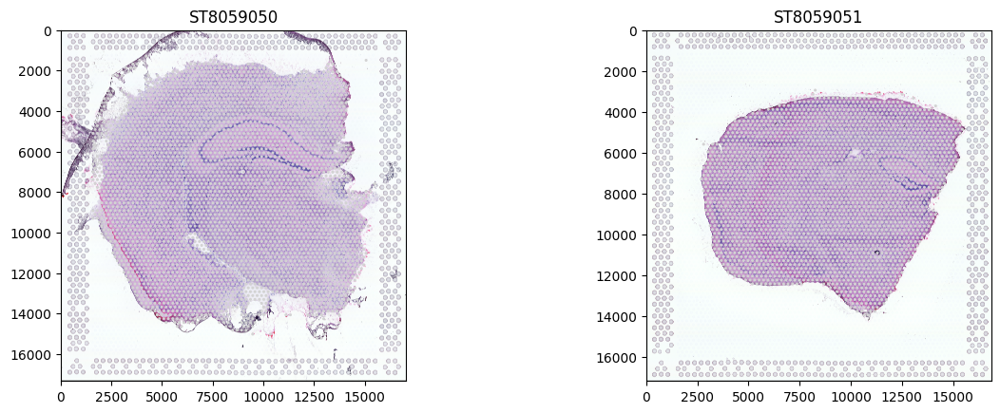

In [ ]:
# visium_sdata = sd.read_zarr("/Users/tim.treis/Documents/GitHub/spatialdata-notebooks/notebooks/examples/visium.zarr")
visium_sdata = sd.read_zarr(DATA_DIR + "visium/data.zarr")

print(visium_sdata)
visium_sdata.pl.render_images().pl.render_shapes().pl.show()
# 

In [ ]:
import multiscale_spatial_image
plt.imshow(visium_sdata.images["Visium_Mouse_Olfactory_Bulb_full_image"]["scale0"].ds.to_array().squeeze(axis=0)[3, ...])

KeyError: 'Visium_Mouse_Olfactory_Bulb_full_image'

/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/basic.py:52: AccessorRegistrationWarning: registration of accessor <class 'spatialdata_plot.pl.basic.PlotAccessor'> under name 'pl' for type <class 'spatialdata._core.spatialdata.SpatialData'> is overriding a preexisting attribute with the same name.
  class PlotAccessor:
/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:265: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _ = _decorate_axs(
/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", Impl

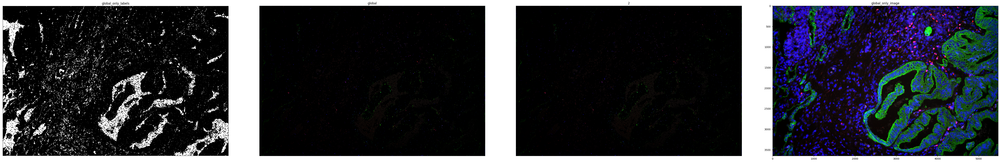

In [ ]:
cosmx = sd.read_zarr(DATA_DIR + "cosmx_io/data.zarr")

(
    cosmx
    .pp.get_elements("2")
    .pl.render_images()
    .pl.render_points()
    .pl.show(figsize=(15,15))
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


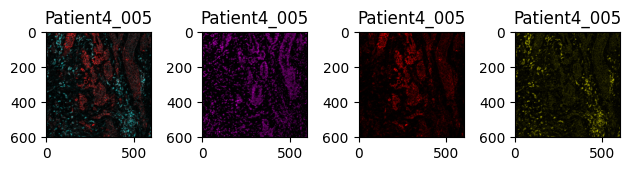

In [ ]:
stein = sd.read_zarr(DATA_DIR + "steinbock_io/data.zarr")

fig, axs = plt.subplots(ncols=4, nrows=1)

(
    stein
    .pp.get_elements("Patient4_005")
    .pl.render_images(channel = [10, 32], palette=["red", "cyan"])
    .pl.show(ax=axs[0])
)
(
    stein
    .pp.get_elements("Patient4_005")
    .pl.render_images(channel = [1], palette=["magenta"])
    .pl.show(ax=axs[1])
)
(
    stein
    .pp.get_elements("Patient4_005")
    .pl.render_images(channel = [10], palette=["red"])
    .pl.show(ax=axs[2])
)
(
    stein
    .pp.get_elements("Patient4_005")
    .pl.render_images(channel = [32], palette=["yellow"])
    .pl.show(ax=axs[3])
)
plt.tight_layout()

In [ ]:
stein.images["Patient1_001_image"]

<xarray.SpatialImage 'Patient1_001_image' (c: 40, y: 600, x: 600)>
dask.array<from-zarr, shape=(40, 600, 600), dtype=float32, chunksize=(1, 600, 600), chunktype=numpy.ndarray>
Coordinates:
  * c        (c) int64 0 1 2 3 4 5 6 7 8 9 10 ... 30 31 32 33 34 35 36 37 38 39
  * y        (y) float64 0.5 1.5 2.5 3.5 4.5 ... 595.5 596.5 597.5 598.5 599.5
  * x        (x) float64 0.5 1.5 2.5 3.5 4.5 ... 595.5 596.5 597.5 598.5 599.5
Attributes:
    transform:  {'Patient1_001': Identity }

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


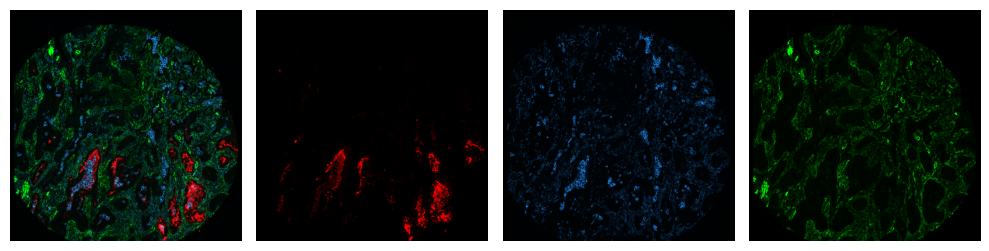

In [ ]:
mcmicro = sd.read_zarr(DATA_DIR + "mcmicro_io/data.zarr")

fig, axs = plt.subplots(ncols=4, nrows=1, figsize=(10,10))

(
    mcmicro
    .pp.get_bb(x=slice(0, 2500), y=slice(500, 3000))
    .pl.render_images(channel = [2,6,7], palette = ["red", "lime", "dodgerblue"])
    .pl.show(ax=axs[0])
)
(
    mcmicro
    .pp.get_bb(x=slice(0, 2500), y=slice(500, 3000))
    .pl.render_images(channel = [2], palette = ["red",])
    .pl.show(ax=axs[1])
)
(
    mcmicro
    .pp.get_bb(x=slice(0, 2500), y=slice(500, 3000))
    .pl.render_images(channel = [7], palette = ["dodgerblue",])
    .pl.show(ax=axs[2])
)
(
    mcmicro
    .pp.get_bb(x=slice(0, 2500), y=slice(500, 3000))
    .pl.render_images(channel = [6], palette = ["lime",])
    .pl.show(ax=axs[3])
)

for ax in axs:
    ax.axis("off")
    ax.set_title(None)
    
    
plt.tight_layout()

In [ ]:
mcmicro.images["exemplar-001_image"].indexes["c"]

# = pd.Index(["red1", "gre3en", "bl4ue", "r5ed", "gree6n", "blu7e", "re8d", "gree9n", "bl0ue", "red", "green", "blue"], name="c")

Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11], dtype='int64', name='c')

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:256: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = ax.scatter(


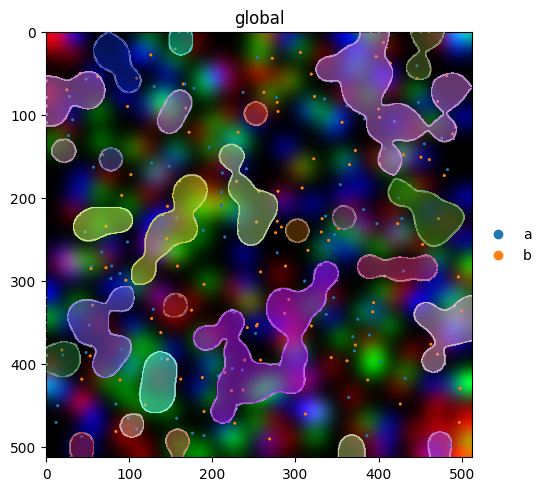

In [ ]:

(
    blobs()
    .pl.render_images()
    .pl.render_labels()
    # .pl.render_shapes()
    .pl.render_points(color = "genes")
    .pl.show()
)

In [ ]:
(
    blobs()
    # .pl.render_images()
    # .pl.render_labels()
    .pl.render_shapes()
    # .pl.render_points(color_key = "genes")
    .pl.show(ax=axs[2])
)

NameError: name 'axs' is not defined

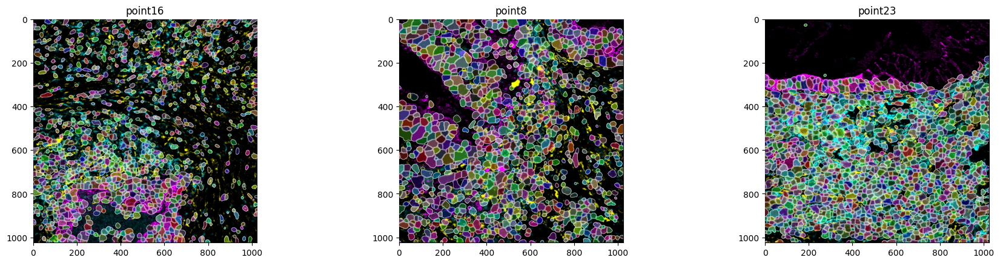

In [ ]:
# Mibi

mibitof = sd.read_zarr(DATA_DIR + "mibitof/data.zarr")

(
    mibitof
    .pl.render_images()
    .pl.render_labels()
    .pl.show()
)

plt.savefig("mibi.png")

# Cosmx

/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/basic.py:52: AccessorRegistrationWarning: registration of accessor <class 'spatialdata_plot.pl.basic.PlotAccessor'> under name 'pl' for type <class 'spatialdata._core.spatialdata.SpatialData'> is overriding a preexisting attribute with the same name.
  class PlotAccessor:


Dropping coordinate system 'global_only_image' since it doesn't have relevant elements.


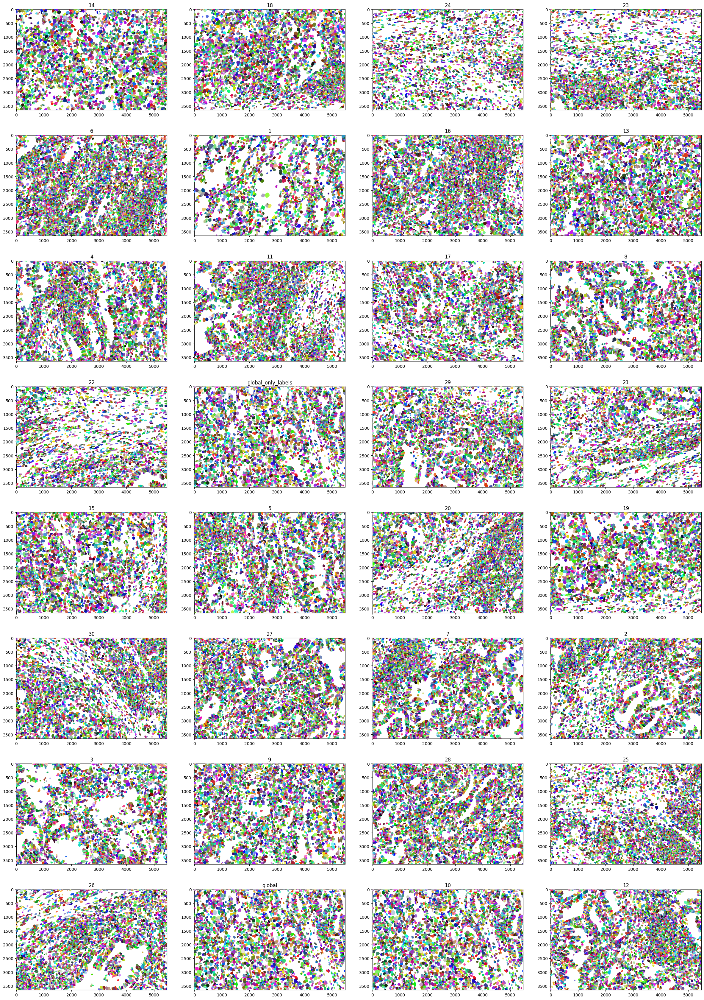

In [ ]:
# Cosmx

cosmx = sd.read_zarr(DATA_DIR + "cosmx_io/data.zarr")
(
    cosmx
    # .pl.render_images()
    .pl.render_labels()
    .pl.show()
)

plt.savefig("cosmx.png")

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


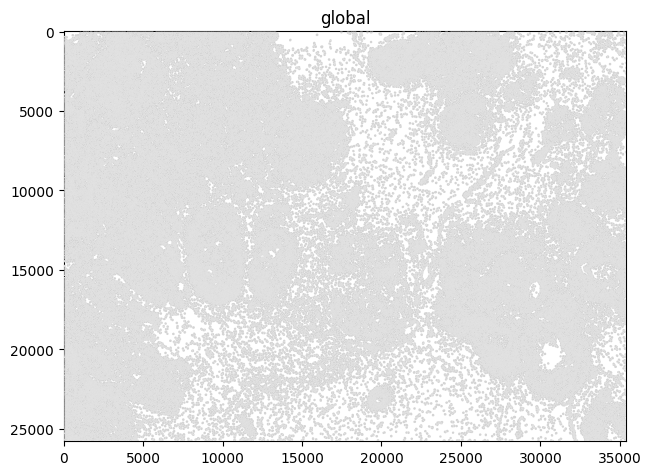

In [ ]:
# Xenium
    
xenium = sd.read_zarr(DATA_DIR + "xenium_rep1_io/data.zarr")

(
    xenium
    .pl.render_shapes()
    .pl.show()
)

# plt.savefig("xenium.png")

In [ ]:
xenium

SpatialData object with:
├── Images
│     ├── 'morphology_focus': MultiscaleSpatialImage[cyx] (1, 25778, 35416), (1, 12889, 17708), (1, 6444, 8854), (1, 3222, 4427), (1, 1611, 2213)
│     └── 'morphology_mip': MultiscaleSpatialImage[cyx] (1, 25778, 35416), (1, 12889, 17708), (1, 6444, 8854), (1, 3222, 4427), (1, 1611, 2213)
├── Points
│     └── 'transcripts': DataFrame with shape: (42638083, 9) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (167780, 1) (2D shapes)
│     ├── 'cell_circles': GeoDataFrame shape: (167780, 2) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (167780, 1) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 167780 × 313
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial': AnnData (167780, 313)
with coordinate systems:


In [ ]:
xenium

SpatialData object with:
├── Images
│     ├── 'morphology_focus': MultiscaleSpatialImage[cyx] (1, 25778, 35416), (1, 12889, 17708), (1, 6444, 8854), (1, 3222, 4427), (1, 1611, 2213)
│     └── 'morphology_mip': MultiscaleSpatialImage[cyx] (1, 25778, 35416), (1, 12889, 17708), (1, 6444, 8854), (1, 3222, 4427), (1, 1611, 2213)
├── Points
│     └── 'transcripts': DataFrame with shape: (42638083, 9) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (167780, 1) (2D shapes)
│     ├── 'cell_circles': GeoDataFrame shape: (167780, 2) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (167780, 1) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 167780 × 313
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial': AnnData (167780, 313)
with coordinate systems:


/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


SpatialData object with:
├── Images
│     └── 'morphology_focus': SpatialImage[cyx] (1, 25778, 35416)
├── Points
│     └── 'transcripts': DataFrame with shape: (42638083, 9) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (167780, 1) (2D shapes)
│     ├── 'cell_circles': GeoDataFrame shape: (167780, 2) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (167780, 1) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 167780 × 313
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial': AnnData (167780, 313)
with coordinate systems:
▸ 'global', with elements:
        morphology_focus (Images), transcripts (Points), cell_boundaries (Shapes), cell_circles (Shapes), nucleus_boundaries (Shapes)


array([<AxesSubplot: title={'center': 'morphology_focus'}>], dtype=object)

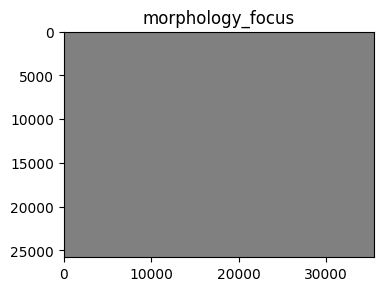

In [ ]:
xenium = sd.read_zarr(DATA_DIR + "xenium_rep1_io/data.zarr")

# print(xenium)

img = Image2DModel.parse(xenium.images["morphology_focus"]["scale0"].ds.to_array().squeeze(axis=0))
xenium.images["morphology_focus"] = img
del xenium.images["morphology_mip"]

print(xenium)

fig, ax = plt.subplots(1,1, figsize=(4,4))

xmin, xmax = [18000, 22000]
ymin, ymax = [21000, 25000]

(
    xenium
    # .pp.get_bb([xmin, xmax], [ymin, ymax])
    .pl.render_images()
    # .pl.render_shapes()
    .pl.show(ax=ax)
)

# ax.set_xlim(xmin, xmax)
# ax.set_ylim(ymin, ymax)

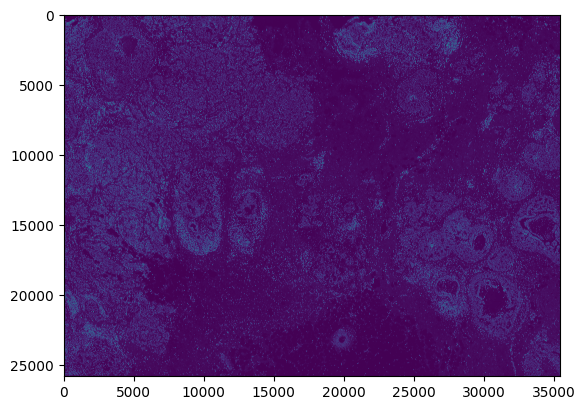

In [ ]:
plt.imshow(xenium.images["morphology_focus"]["scale0"].ds.to_array().squeeze())

In [ ]:
import multiscale_spatial_image
isinstance(xenium.images["morphology_focus"], multiscale_spatial_image.multiscale_spatial_image.MultiscaleSpatialImage)

True

SpatialData object with:
├── Images
│     └── '17_image': SpatialImage[cyx] (3, 3648, 5472)
├── Labels
│     └── '17_labels': SpatialImage[yx] (3648, 5472)
├── Points
│     └── '17_points': DataFrame with shape: (<Delayed>, 9) (2D points)
└── Table
      └── AnnData object with n_obs × n_vars = 3551 × 980
    obs: 'fov', 'Area', 'AspectRatio', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'fov_labels', 'cell_ID'
    uns: 'spatialdata_attrs'
    obsm: 'global', 'spatial': AnnData (3551, 980)
with coordinate systems:
▸ '17', with elements:
        17_image (Images), 17_labels (Labels), 17_points (Points)
▸ 'global', with elements:
        17_image (Images), 17_labels (Labels), 17_points (Points)
▸ 'global_only_image', with elements:
        17_image (Images)
▸ 'global_only_labels', with elements:
        17_labels (Labels), 17_points (Points)


/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:224: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = AnnData(X=points[["x", "y"]].values, obs=points[coords].reset_index())
/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:246: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = ax.scatter(
/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:224: FutureWarning: X.dtype being converted to np.fl

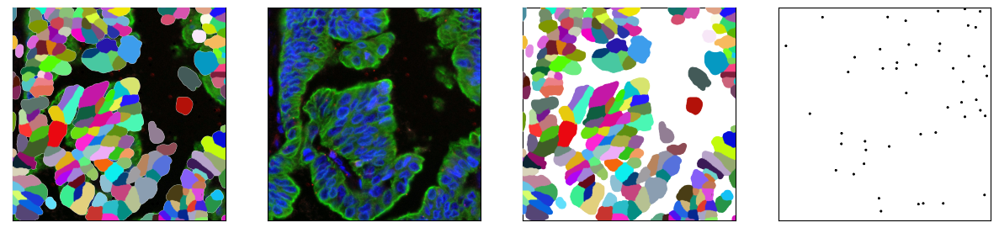

In [ ]:
# cosmx

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import spatialdata as sd
import scanpy as sc
from spatialdata.datasets import blobs, raccoon
from spatialdata.models import (
    Image2DModel,
)

import spatialdata_plot
assert spatialdata_plot.__name__ == "spatialdata_plot" # so mypy doesn't complain

DATA_DIR = "/Users/tim.treis/Documents/GitHub/spatialdata-sandbox/"

cosmx = sd.read_zarr(DATA_DIR + "cosmx_io/data.zarr")
cosmx = cosmx.pp.get_elements("17")
cosmx.points["17_points"] = cosmx.points["17_points"].sample(frac=0.0006)

print(cosmx)

xmin, xmax = 1000, 3648
ymin, ymax = 1000, 3648

fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(15, 15))

(
    cosmx
    .pp.get_elements("17")
    .pp.get_bb([xmin, xmax], [ymin, ymax])
    .pl.render_images()
    .pl.render_labels(palette="cyan")
    .pl.render_points(palette="red")
    .pl.show(coordinate_system="global", ax=axs[0])
)
(
    cosmx
    .pp.get_elements("17")
    .pp.get_bb([xmin, xmax], [ymin, ymax])
    .pl.render_images()
    # .pl.render_labels()
    # .pl.render_points(palette="red")
    .pl.show(coordinate_system="global", ax=axs[1])
)
(
    cosmx
    .pp.get_elements("17")
    .pp.get_bb([xmin, xmax], [ymin, ymax])
    # .pl.render_images()
    .pl.render_labels(palette="cyan")
    # .pl.render_points(palette="red")
    .pl.show(coordinate_system="global", ax=axs[2])
)
(
    cosmx
    .pp.get_elements("17")
    .pp.get_bb([xmin, xmax], [ymin, ymax])
    # .pl.render_images()
    # .pl.render_labels()
    .pl.render_points(palette="red")
    .pl.show(coordinate_system="global", ax=axs[3])
)

for ax in axs:
    ax.set_aspect("equal")
    ax.set_xlim(0, 1024)
    ax.set_ylim(0, 1024)
    ax.set_xticks([])
    ax.set_yticks([])

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


SpatialData object with:
├── Images
│     └── 'morphology_focus': SpatialImage[cyx] (1, 25778, 35416)
├── Points
│     └── 'transcripts': DataFrame with shape: (<Delayed>, 9) (3D points)
├── Shapes
│     └── 'cell_circles': GeoDataFrame shape: (167780, 2) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 167780 × 313
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial': AnnData (167780, 313)
with coordinate systems:
▸ 'global', with elements:
        morphology_focus (Images), transcripts (Points), cell_circles (Shapes)


/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = ax.scatter(


None
['#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#0000000

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = ax.scatter(


None
['#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#0000000

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/tim.treis/Documents/GitHub/spatialdata-plot/src/spatialdata_plot/pl/render.py:258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = ax.scatter(


None
['#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#00000000' '#00000000' '#00000000'
 '#00000000' '#00000000' '#00000000' '#0000000

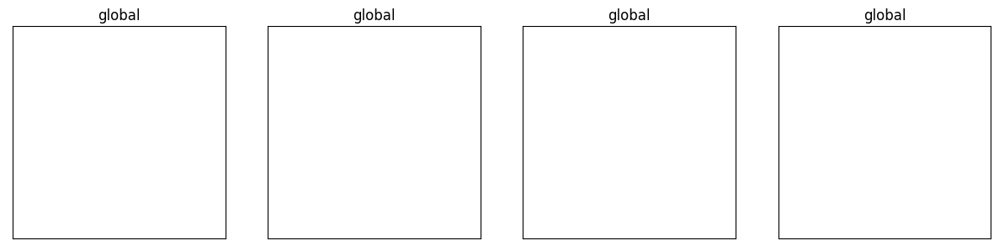

In [ ]:
xenium = sd.read_zarr(DATA_DIR + "xenium_rep1_io/data.zarr")

# print(xenium)

img = Image2DModel.parse(xenium.images["morphology_focus"]["scale0"].ds.to_array().squeeze(axis=0))
xenium.images["morphology_focus"] = img
del xenium.images["morphology_mip"]
del xenium.shapes["nucleus_boundaries"]
del xenium.shapes["cell_boundaries"]
xenium.points["transcripts"] = xenium.points["transcripts"].sample(frac=0.000003)

print(xenium)



fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(15, 15))

xmin, xmax = [19000, 21000]
ymin, ymax = [22000, 24000]

(
    xenium
    .pp.get_bb([xmin, xmax], [ymin, ymax])
    .pl.render_images(palette="viridis")
    # .pl.render_points()
    # .pl.render_shapes()
    .pl.show(ax=axs[0])
)

(
    xenium
    # .pp.get_bb([xmin, xmax], [ymin, ymax])
    # .pl.render_images(trans_fun = lambda x: np.log10(x))
    .pl.render_points(palette="red")
    # .pl.render_shapes()
    .pl.show(ax=axs[1])
)

(
    xenium
    # .pp.get_bb([xmin, xmax], [ymin, ymax])
    # .pl.render_images(trans_fun = lambda x: np.log10(x))
    # .pl.render_points()
    .pl.render_shapes()
    .pl.show(ax=axs[2])
)

(
    xenium
    .pp.get_bb([xmin, xmax], [ymin, ymax])
    .pl.render_images(palette="viridis")
    .pl.render_points(palette="red")
    .pl.render_shapes()
    .pl.show(ax=axs[3])
)

for ax in axs:
    ax.set_aspect("equal")
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_xticks([])
    ax.set_yticks([])

/Users/tim.treis/anaconda3/envs/spatialdata/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


SpatialData object with:
├── Images
│     ├── 'ST8059050_image': SpatialImage[cyx] (3, 2000, 1968)
│     └── 'ST8059051_image': SpatialImage[cyx] (3, 2000, 1963)
├── Shapes
│     ├── 'ST8059050_shapes': GeoDataFrame shape: (3497, 2) (2D shapes)
│     ├── 'ST8059051_shapes': GeoDataFrame shape: (2409, 2) (2D shapes)
│     └── 'polygon': GeoDataFrame shape: (1, 1) (2D shapes)
└── Table
      └── AnnData object with n_obs × n_vars = 5906 × 31053
    obs: 'in_tissue', 'array_row', 'array_col', 'annotating', 'library', 'spot_id'
    uns: 'spatialdata_attrs': AnnData (5906, 31053)
with coordinate systems:
▸ 'ST8059050', with elements:
        ST8059050_image (Images), ST8059050_shapes (Shapes)
▸ 'ST8059051', with elements:
        ST8059051_image (Images), ST8059051_shapes (Shapes)
▸ 'global', with elements:
        polygon (Shapes)
how ST8059050_shapes
annotating
                    Xkr4  Gm1992  Gm37381  Rp1  Sox17  Gm37323  Mrpl15  \
AAACAAGTATCTCCCA-1   1.0     0.0      0.0  0.0    0.0  

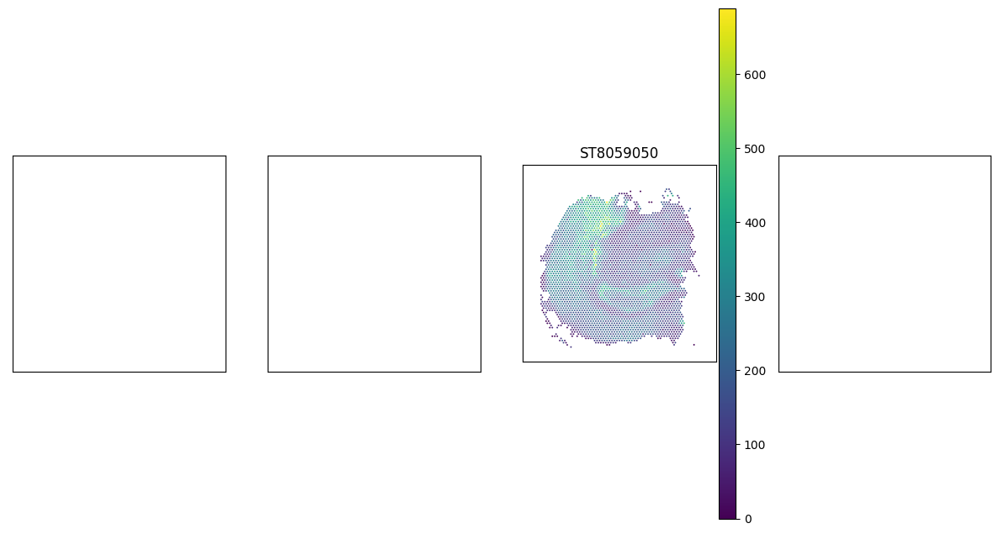

In [ ]:
visium = sd.read_zarr(DATA_DIR + "visium/data.zarr")

print(visium)

fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(15, 15), sharex=True, sharey=True)

# (
#     visium
#     .pp.get_elements("ST8059050")
#     .pl.render_images()
#     .pl.render_shapes(color = "mt-Cytb", groups = "spot_id")
#     .pl.show(axs[1])
# )
# (
#     visium
#     .pp.get_elements("ST8059050")
#     .pl.render_images()
#     # .pl.render_shapes(color_key = "Xkr4", groups = "spot_id")
#     .pl.show(axs[0])
# )
(
    visium
    .pp.get_elements("ST8059050")
    # .pl.render_images()
    .pl.render_shapes(color = "mt-Cytb", groups = "spot_id")
    .pl.show(ax=axs[2])
)

for ax in axs:
    ax.set_aspect("equal")
    ax.set_xlim(0, int(1968*8.6670002))
    ax.set_ylim(0, int(2000*8.6670002))
    ax.set_xticks([])
    ax.set_yticks([])

In [ ]:
blobs().table.uns

OverloadedDict, wrapping:
	OrderedDict([('spatialdata_attrs', {'region': 'blobs_labels', 'region_key': 'region', 'instance_key': 'instance_id'})])
With overloaded keys:
	['neighbors'].

In [ ]:
visium.images["ST8059050_image"]

<xarray.SpatialImage 'ST8059050_image' (c: 3, y: 2000, x: 1968)>
dask.array<from-zarr, shape=(3, 2000, 1968), dtype=uint8, chunksize=(3, 2000, 1968), chunktype=numpy.ndarray>
Coordinates:
  * c        (c) int64 0 1 2
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 1.996e+03 1.998e+03 1.998e+03 2e+03
  * x        (x) float64 0.5 1.5 2.5 3.5 ... 1.966e+03 1.966e+03 1.968e+03
Attributes:
    transform:  {'ST8059050': Scale (c, y, x)\n    [1.        8.6670002 8.667...

In [ ]:
visium.table.to_df().sum().sort_values()

Gm11378                0.0
2610204G07Rik          0.0
Gm5930                 0.0
Gm17160                0.0
Gm8229                 0.0
                   ...    
mt-Cytb          1439108.0
mt-Co2           2264612.0
mt-Atp6          2351509.0
mt-Co1           3214796.0
mt-Co3           3445329.0
Length: 31053, dtype: float32